In [1]:
import torch
import torch.nn as nn
import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
from numba import njit

In [2]:
@njit
def explicit_diff_scheme(f_0, h, tau, T, a, q):

    t_list = [0]
    val_list = [f_0]

    t = 0
    t1 = 0
    f = f_0.copy()

    while t < T:
        t += tau
        t1 += tau

        f2 = f.copy()

        f2[1:-1] += a * tau / \
            (h * h) * (f[:-2] - 2 * f[1:-1] + f[2:])

        f2[0] = f2[1] + q * h
        # f2[0] = ((f2[1] + q * h) * 2 * a * tau + h * h * f[0]) \
        # / (h * h + 2 * a * tau)

        if t1 >= h:
            t_list.append(t)
            val_list.append(f2.copy())
            t1 -= h

        f = f2.copy()

    return t_list, val_list

In [3]:
X_MAX = 1
T_MAX = 1
N = 1001
q = 10

x = np.linspace(0, X_MAX, N)
t = np.linspace(0, T_MAX, N)

f_0 = np.zeros_like(x)

h = X_MAX / (N - 1)
tau = h ** 2 / (4 * 0.5)

t, u1 = explicit_diff_scheme(f_0, h, tau, T_MAX, 0.1, q)
t, u2 = explicit_diff_scheme(f_0, h, tau, T_MAX, 0.5, q)
t = np.array(t)
u1, u2 = np.array(u1), np.array(u2)

In [4]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(device)

cuda:0


In [ ]:
def pde_loss(model, points, coll_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]

    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_t = torch.autograd.grad(
        u, t,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_xx = torch.autograd.grad(
        u_x, x,
        grad_outputs=torch.ones_like(u_x),
        create_graph=True
    )[0]

    residual = u_t - alpha * u_xx

    loss = torch.mean((residual * coll_weights) ** 2)

    return loss


def LB_loss(model, points, q, left_bound_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]
    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    residual = u_x + q

    loss = torch.mean((residual * left_bound_weights) ** 2)

    return loss


def RB_loss(model, points, right_bound_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]
    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    residual = u

    loss = torch.mean((residual * right_bound_weights) ** 2)

    return loss


def RB_dt_loss(model, points, right_bound_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]
    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_t = torch.autograd.grad(
        u, t,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    residual = u_t

    loss = torch.mean((residual * right_bound_weights) ** 2)

    return loss


def IC_loss(model, points, init_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]
    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    residual = u

    loss = torch.mean((residual * init_weights) ** 2)

    return loss


def IC_dx_loss(model, points, init_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]
    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    residual = u_x

    loss = torch.mean((residual * init_weights) ** 2)

    return loss

In [ ]:
def weights(n):
    return nn.Parameter(torch.full((n, 1), 1.0).to(device))


class PINN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(PINN, self).__init__()
        self.net = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.Tanh(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.Tanh(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.Tanh(),
            nn.Linear(hidden_dim, hidden_dim),
            nn.Tanh(),
            nn.Linear(hidden_dim, output_dim)
        )

    def forward(self, x):
        return self.net(x)


class AdaptivePINN(nn.Module):
    def __init__(self, input_dim, hidden_dim, output_dim):
        super(AdaptivePINN, self).__init__()
        self.pinn = PINN(input_dim, hidden_dim, output_dim)

        self.coll_weights = weights(10000)
        self.left_bound_weights = weights(2000)
        self.right_bound_weights = weights(2000)
        self.init_weights = weights(2000)
        self.data_weights = weights(10000)

    def forward(self, x):
        return self.pinn(x)

    def loss(self, coll_data, lb_data, rb_data, init_data, q, data_data=None):
        coll_loss = pde_loss(self, coll_data, self.coll_weights)
        lb_loss = LB_loss(self, lb_data, q, self.left_bound_weights)

        rb_loss = RB_loss(self, rb_data, self.right_bound_weights)
        rb_dt_loss = RB_dt_loss(self, rb_data, self.right_bound_weights)

        init_loss = IC_loss(self, init_data, self.init_weights)
        init_dx_loss = IC_dx_loss(self, init_data, self.init_weights)

        total_loss = coll_loss + lb_loss + rb_loss + \
            init_loss + rb_dt_loss + init_dx_loss

        if data_data is not None:
            x, t, alpha, y_true = data_data[:, :1], data_data[:, 1:2], \
                data_data[:, 2:3], data_data[:, 3:]
            x.requires_grad_(True)
            t.requires_grad_(True)
            alpha.requires_grad_(True)

            inputs = torch.cat([x, t, alpha], dim=1)
            u = self(inputs)

            residual = u - y_true

            total_loss += torch.mean((residual * self.data_weights) ** 2)

        return total_loss

In [ ]:
num_points = 2000
coll_t = torch.rand(num_points * 5, 1).to(device)
coll_x = torch.rand_like(coll_t).to(device)
coll_a = (torch.randint_like(coll_t, 0, 2).to(device) * 4 + 1) / 10

init_x = torch.rand(num_points, 1).to(device)
init_t = torch.zeros_like(init_x).to(device)
init_a = (torch.randint_like(init_x, 0, 2).to(device) * 4 + 1) / 10

left_bound_t = torch.rand(num_points, 1).to(device)
left_bound_x = torch.full_like(left_bound_t, 0).to(device)
left_bound_a = (torch.randint_like(left_bound_t, 0, 2).to(device) * 4 + 1) / 10

right_bound_t = torch.rand(num_points, 1).to(device)
right_bound_x = torch.full_like(right_bound_t, 1).to(device)
right_bound_a = (
    torch.randint_like(
        right_bound_t, 0, 2).to(device) * 4 + 1) / 10

In [ ]:
alpha = 0.5
input_dim = 3
hidden_dim = 20
output_dim = 1
q = 10

model = AdaptivePINN(input_dim, hidden_dim, output_dim)
model = model.to(device)

optimizer = torch.optim.Adam(
    [param for name, param in
     model.named_parameters() if "weights" not in name],
    lr=0.001
)
weights_optimizer = torch.optim.Adam(
    [param for name, param in
     model.named_parameters() if "weights" in name],
    lr=0.0001
)

coll_weights_history = []

epochs = 10000
model.train()
for epoch in range(epochs):
    optimizer.zero_grad()
    weights_optimizer.zero_grad()

    loss = model.loss(
        torch.cat(
            [
                coll_x,
                coll_t,
                coll_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                left_bound_x,
                left_bound_t,
                left_bound_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                right_bound_x,
                right_bound_t,
                right_bound_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                init_x,
                init_t,
                init_a,
            ],
            dim=1,
        ),
        q)

    loss.backward()
    optimizer.step()
    weights_optimizer.step()

    if epoch % 100 == 0:
        with torch.autograd.no_grad():
            print(f"Epoch {epoch}, Loss: {loss.item()}")
    if epoch % 3333 == 0:
        with torch.autograd.no_grad():
            coll_weights_history.append(model.coll_weights.clone())

d:\ML\.venv\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Epoch 0, Loss: 99.54463195800781
Epoch 100, Loss: 26.43775177001953
Epoch 200, Loss: 16.541812896728516
Epoch 300, Loss: 9.108148574829102
Epoch 400, Loss: 6.41206169128418
Epoch 500, Loss: 5.086672782897949
Epoch 600, Loss: 4.149389743804932
Epoch 700, Loss: 3.4363162517547607
Epoch 800, Loss: 2.8133459091186523
Epoch 900, Loss: 2.29997181892395
Epoch 1000, Loss: 1.917929768562317
Epoch 1100, Loss: 1.6384152173995972
Epoch 1200, Loss: 1.4261378049850464
Epoch 1300, Loss: 1.2557258605957031
Epoch 1400, Loss: 1.1068356037139893
Epoch 1500, Loss: 0.973744809627533
Epoch 1600, Loss: 0.8597370982170105
Epoch 1700, Loss: 0.7656658887863159
Epoch 1800, Loss: 0.6942417025566101
Epoch 1900, Loss: 0.6205803155899048
Epoch 2000, Loss: 0.5613113045692444
Epoch 2100, Loss: 0.5076286792755127
Epoch 2200, Loss: 0.4603140652179718
Epoch 2300, Loss: 0.41783013939857483
Epoch 2400, Loss: 0.3785059452056885
Epoch 2500, Loss: 0.342340350151062
Epoch 2600, Loss: 0.3089103400707245
Epoch 2700, Loss: 0.2878

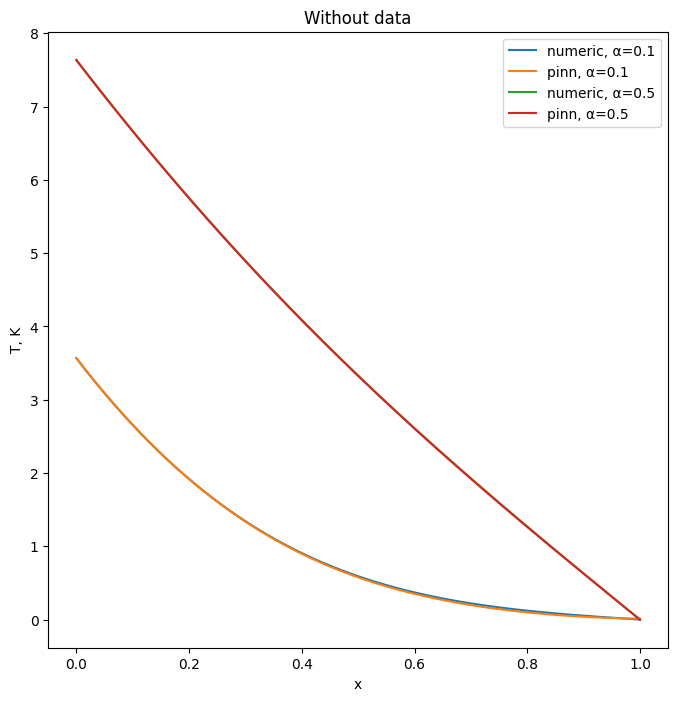

In [ ]:
x = torch.linspace(0, 1, 1000).reshape(-1, 1).to(device)
t = torch.full_like(x, 1).to(device)

a = torch.full_like(x, 0.1).to(device)
inputs = torch.cat([x, t, a], dim=1)
res = model(inputs)

a = torch.full_like(x, 0.5).to(device)
inputs = torch.cat([x, t, a], dim=1)
res2 = model(inputs)

plt.figure(figsize=(8, 8))
plt.plot(np.linspace(0, X_MAX, N), u1[-1], label='numeric, α=0.1')
plt.plot(
    x.cpu().detach().numpy(),
    res.cpu().detach().numpy(),
    label='pinn, α=0.1')
plt.plot(np.linspace(0, X_MAX, N), u2[-1], label='numeric, α=0.5')
plt.plot(
    x.cpu().detach().numpy(),
    res2.cpu().detach().numpy(),
    label='pinn, α=0.5')
plt.ylabel('T, K')
plt.xlabel('x')
plt.legend()
plt.title('Without data')
plt.show()

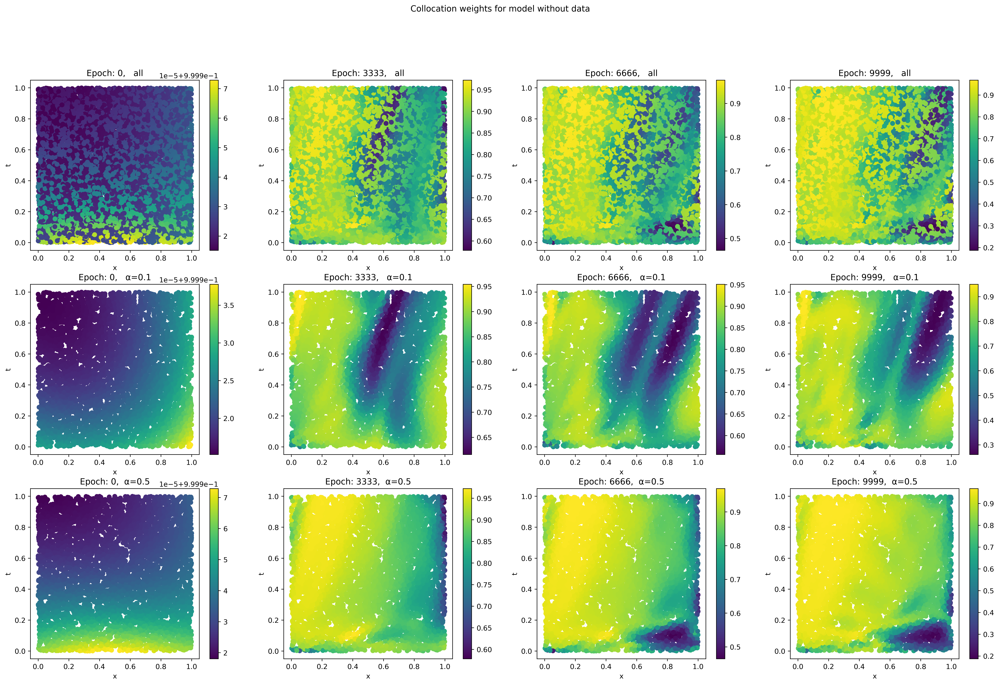

In [ ]:
fig, ax = plt.subplots(3, 4, figsize=(25, 15), dpi=400)

for i, w in enumerate(coll_weights_history):
    sc1 = ax[0][i].scatter(
        coll_x.cpu(),
        coll_t.cpu(),
        c=w.cpu().detach().numpy())
    fig.colorbar(sc1, ax=ax[0][i])
    ax[0][i].set_xlabel('x')
    ax[0][i].set_ylabel('t')
    ax[0][i].set_title(f'Epoch: {i * 3333},   all')

    sc1 = ax[1][i].scatter(coll_x[coll_a == 0.1].cpu(),
                           coll_t[coll_a == 0.1].cpu(),
                           c=w[coll_a == 0.1].cpu().detach().numpy())
    fig.colorbar(sc1, ax=ax[1][i])
    ax[1][i].set_xlabel('x')
    ax[1][i].set_ylabel('t')
    ax[1][i].set_title(f'Epoch: {i * 3333},   α=0.1')

    sc1 = ax[2][i].scatter(coll_x[coll_a == 0.5].cpu(),
                           coll_t[coll_a == 0.5].cpu(),
                           c=w[coll_a == 0.5].cpu().detach().numpy())
    fig.colorbar(sc1, ax=ax[2][i])
    ax[2][i].set_xlabel('x')
    ax[2][i].set_ylabel('t')
    ax[2][i].set_title(f'Epoch: {i * 3333},  α=0.5')

plt.suptitle('Collocation weights for model without data')
plt.show()

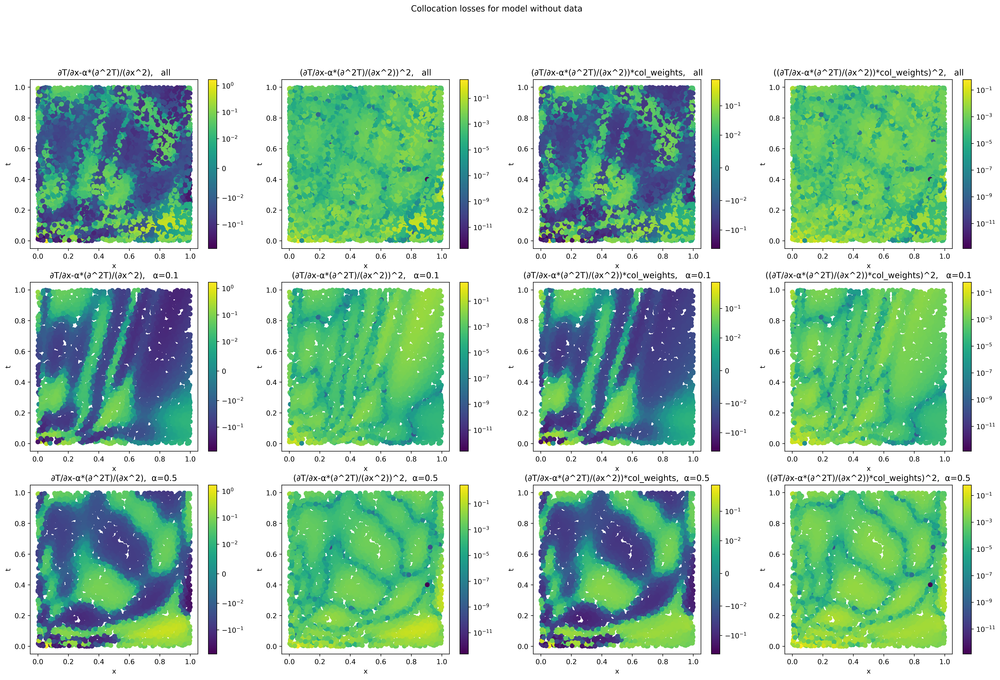

In [ ]:
def pde_loss_no_mean(model, points, coll_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]

    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_t = torch.autograd.grad(
        u, t,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_xx = torch.autograd.grad(
        u_x, x,
        grad_outputs=torch.ones_like(u_x),
        create_graph=True
    )[0]

    residual = u_t - alpha * u_xx

    loss = (residual * coll_weights) ** 2

    return loss


def pde_loss_no_mean_no_square(model, points, coll_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]

    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_t = torch.autograd.grad(
        u, t,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_xx = torch.autograd.grad(
        u_x, x,
        grad_outputs=torch.ones_like(u_x),
        create_graph=True
    )[0]

    residual = u_t - alpha * u_xx

    loss = residual * coll_weights

    return loss


def pde_loss_no_mean_no_weights(model, points, coll_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]

    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_t = torch.autograd.grad(
        u, t,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_xx = torch.autograd.grad(
        u_x, x,
        grad_outputs=torch.ones_like(u_x),
        create_graph=True
    )[0]

    residual = u_t - alpha * u_xx

    loss = residual ** 2

    return loss


def pde_loss_no_mean_no_square_no_weights(model, points, coll_weights):
    x, t, alpha = points[:, :1], points[:, 1:2], points[:, 2:]

    x.requires_grad_(True)
    t.requires_grad_(True)
    alpha.requires_grad_(True)

    inputs = torch.cat([x, t, alpha], dim=1)
    u = model(inputs)

    u_t = torch.autograd.grad(
        u, t,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_x = torch.autograd.grad(
        u, x,
        grad_outputs=torch.ones_like(u),
        create_graph=True
    )[0]

    u_xx = torch.autograd.grad(
        u_x, x,
        grad_outputs=torch.ones_like(u_x),
        create_graph=True
    )[0]

    residual = u_t - alpha * u_xx

    loss = residual

    return loss


losses = {
    '∂T/∂x-α*(∂^2T)/(∂x^2)': [pde_loss_no_mean_no_square_no_weights,
                              colors.SymLogNorm(linthresh=1e-2)],
    '(∂T/∂x-α*(∂^2T)/(∂x^2))^2': [pde_loss_no_mean_no_weights,
                                  colors.LogNorm()],
    '(∂T/∂x-α*(∂^2T)/(∂x^2))*col_weights': [pde_loss_no_mean_no_square,
                                            colors.SymLogNorm(linthresh=1e-2)],
    '((∂T/∂x-α*(∂^2T)/(∂x^2))*col_weights)^2': [pde_loss_no_mean,
                                                colors.LogNorm()],
}

model.eval()

fig, ax = plt.subplots(3, 4, figsize=(25, 15), dpi=400)

for i, l in enumerate(losses):
    sc1 = ax[0][i].scatter(
        coll_x.cpu(),
        coll_t.cpu(),
        c=losses[l][0](
            model,
            torch.cat([coll_x,
                       coll_t,
                       coll_a],
                      dim=1),
            model.coll_weights).cpu().detach().numpy(),
        norm=losses[l][1])
    fig.colorbar(sc1, ax=ax[0][i])
    ax[0][i].set_xlabel('x')
    ax[0][i].set_ylabel('t')
    ax[0][i].set_title(f'{l},   all')

    xxxxx = losses[l][0](
        model,
        torch.cat([coll_x,
                   coll_t,
                   coll_a],
                  dim=1),
        model.coll_weights)[coll_a == 0.1].cpu().detach().numpy()

    sc1 = ax[1][i].scatter(
        coll_x[coll_a == 0.1].cpu(),
        coll_t[coll_a == 0.1].cpu(),
        c=losses[l][0](
            model,
            torch.cat([coll_x,
                       coll_t,
                       coll_a],
                      dim=1),
            model.coll_weights)[coll_a == 0.1].cpu().detach().numpy(),
        norm=losses[l][1])
    fig.colorbar(sc1, ax=ax[1][i])
    ax[1][i].set_xlabel('x')
    ax[1][i].set_ylabel('t')
    ax[1][i].set_title(f'{l},   α=0.1')

    sc1 = ax[2][i].scatter(
        coll_x[coll_a == 0.5].cpu(),
        coll_t[coll_a == 0.5].cpu(),
        c=losses[l][0](
            model,
            torch.cat([coll_x,
                       coll_t,
                       coll_a],
                      dim=1),
            model.coll_weights)[coll_a == 0.5].cpu().detach().numpy(),
        norm=losses[l][1])
    fig.colorbar(sc1, ax=ax[2][i])
    ax[2][i].set_xlabel('x')
    ax[2][i].set_ylabel('t')
    ax[2][i].set_title(f'{l},  α=0.5')

plt.suptitle('Collocation losses for model without data')
plt.show()

In [ ]:
x = torch.tensor(np.linspace(0, X_MAX, N)).to(device)
t = torch.tensor(np.linspace(0, T_MAX, N)).to(device)
u = torch.tensor(np.array([u1, u2])).to(device)

data_t_idx = torch.randint(0, len(x), (num_points * 5,)).to(device)
data_x_idx = torch.randint_like(data_t_idx, 0, len(t)).to(device)
data_a_idx = torch.randint_like(data_t_idx, 0, 2).to(device)

data_t = t[data_t_idx].reshape(-1, 1).float()
data_x = x[data_x_idx].reshape(-1, 1).float()
data_a = ((data_a_idx * 4 + 1) / 10).reshape(-1, 1)
data_u = u[data_a_idx, data_t_idx, data_x_idx].reshape(-1, 1).float()

In [ ]:
input_dim = 3
hidden_dim = 20
output_dim = 1
q = 10

model_with_data = AdaptivePINN(input_dim, hidden_dim, output_dim)
model_with_data = model_with_data.to(device)

optimizer = torch.optim.Adam(
    [param for name, param in
     model_with_data.named_parameters() if "weights" not in name],
    lr=0.001
)
weights_optimizer = torch.optim.Adam(
    [param for name, param in
     model_with_data.named_parameters() if "weights" in name],
    lr=0.0001
)

coll_weights_history2 = []

epochs = 10000
for epoch in range(epochs):
    optimizer.zero_grad()
    weights_optimizer.zero_grad()

    loss = model_with_data.loss(
        torch.cat(
            [
                coll_x,
                coll_t,
                coll_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                left_bound_x,
                left_bound_t,
                left_bound_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                right_bound_x,
                right_bound_t,
                right_bound_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                init_x,
                init_t,
                init_a,
            ],
            dim=1,
        ),
        torch.cat(
            [
                data_x,
                data_t,
                data_a,
                data_u,
            ],
            dim=1,
        ),
    )

    loss.backward()
    optimizer.step()
    weights_optimizer.step()

    if epoch % 100 == 0:
        with torch.autograd.no_grad():
            print(f"Epoch {epoch}, Loss: {loss.item()}")

    if epoch % 3333 == 0:
        with torch.autograd.no_grad():
            coll_weights_history2.append(model_with_data.coll_weights.clone())

Epoch 0, Loss: 104.31991577148438
Epoch 100, Loss: 32.7247314453125
Epoch 200, Loss: 14.898628234863281
Epoch 300, Loss: 9.231294631958008
Epoch 400, Loss: 6.281754970550537
Epoch 500, Loss: 4.787075996398926
Epoch 600, Loss: 3.9668917655944824
Epoch 700, Loss: 3.363563299179077
Epoch 800, Loss: 2.849052667617798
Epoch 900, Loss: 2.407835006713867
Epoch 1000, Loss: 2.023841619491577
Epoch 1100, Loss: 1.703589916229248
Epoch 1200, Loss: 1.4473544359207153
Epoch 1300, Loss: 1.2413138151168823
Epoch 1400, Loss: 1.0786110162734985
Epoch 1500, Loss: 0.9479403495788574
Epoch 1600, Loss: 0.839314877986908
Epoch 1700, Loss: 0.7470663189888
Epoch 1800, Loss: 0.6669273376464844
Epoch 1900, Loss: 0.5854843854904175
Epoch 2000, Loss: 0.48043614625930786
Epoch 2100, Loss: 0.36828693747520447
Epoch 2200, Loss: 0.30102306604385376
Epoch 2300, Loss: 0.2621658146381378
Epoch 2400, Loss: 0.23753312230110168
Epoch 2500, Loss: 0.218486025929451
Epoch 2600, Loss: 0.20226190984249115
Epoch 2700, Loss: 0.187

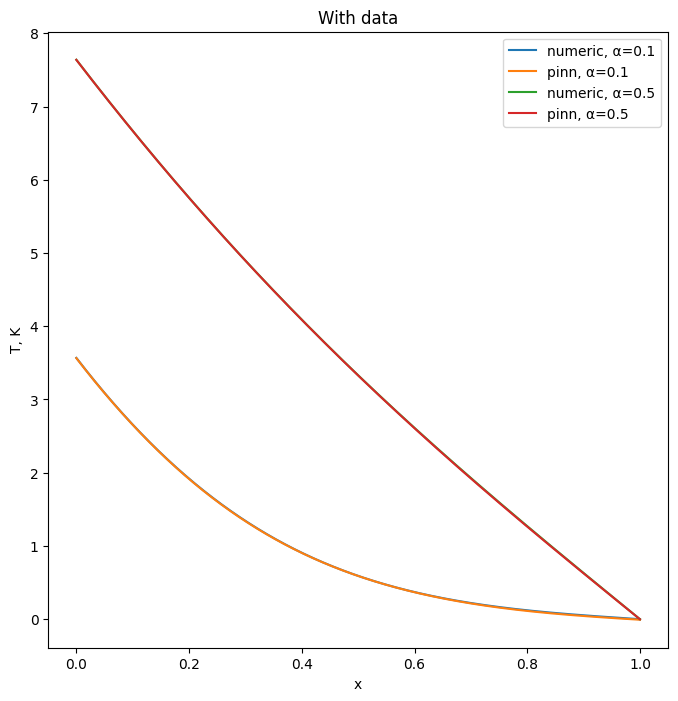

In [ ]:
x = torch.linspace(0, 1, 1000).reshape(-1, 1).to(device)
t = torch.full_like(x, 1).to(device)

a = torch.full_like(x, 0.1).to(device)
inputs = torch.cat([x, t, a], dim=1)
res = model_with_data(inputs)

a = torch.full_like(x, 0.5).to(device)
inputs = torch.cat([x, t, a], dim=1)
res2 = model_with_data(inputs)

plt.figure(figsize=(8, 8))
plt.plot(np.linspace(0, X_MAX, N), u1[-1], label='numeric, α=0.1')
plt.plot(
    x.cpu().detach().numpy(),
    res.cpu().detach().numpy(),
    label='pinn, α=0.1')
plt.plot(np.linspace(0, X_MAX, N), u2[-1], label='numeric, α=0.5')
plt.plot(
    x.cpu().detach().numpy(),
    res2.cpu().detach().numpy(),
    label='pinn, α=0.5')
plt.ylabel('T, K')
plt.xlabel('x')
plt.legend()
plt.title('With data')
plt.show()

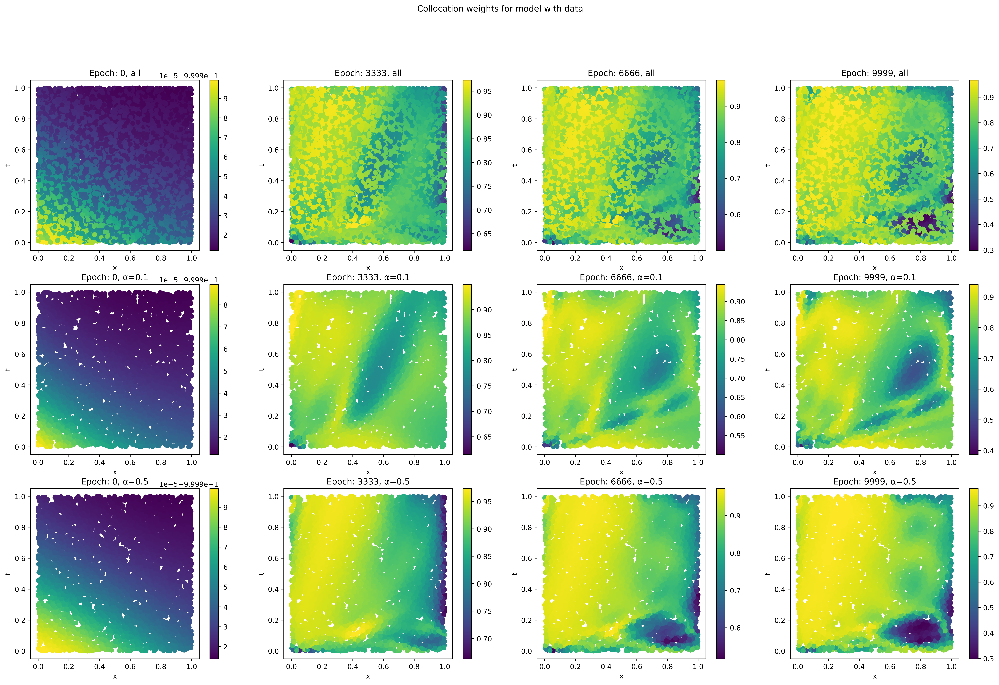

In [ ]:
fig, ax = plt.subplots(3, 4, figsize=(25, 15), dpi=400)

for i, w in enumerate(coll_weights_history2):
    sc1 = ax[0][i].scatter(coll_x.cpu(), coll_t.cpu(), c=w.cpu().detach().numpy())
    fig.colorbar(sc1, ax=ax[0][i])
    ax[0][i].set_xlabel('x')
    ax[0][i].set_ylabel('t')
    ax[0][i].set_title(f'Epoch: {i * 3333}, all')

    sc1 = ax[1][i].scatter(coll_x[coll_a == 0.1].cpu(), coll_t[coll_a == 0.1].cpu(), c=w[coll_a == 0.1].cpu().detach().numpy())
    fig.colorbar(sc1, ax=ax[1][i])
    ax[1][i].set_xlabel('x')
    ax[1][i].set_ylabel('t')
    ax[1][i].set_title(f'Epoch: {i * 3333}, α=0.1')

    sc1 = ax[2][i].scatter(coll_x[coll_a == 0.5].cpu(), coll_t[coll_a == 0.5].cpu(), c=w[coll_a == 0.5].cpu().detach().numpy())
    fig.colorbar(sc1, ax=ax[2][i])
    ax[2][i].set_xlabel('x')
    ax[2][i].set_ylabel('t')
    ax[2][i].set_title(f'Epoch: {i * 3333}, α=0.5')

plt.suptitle('Collocation weights for model with data')
plt.show()

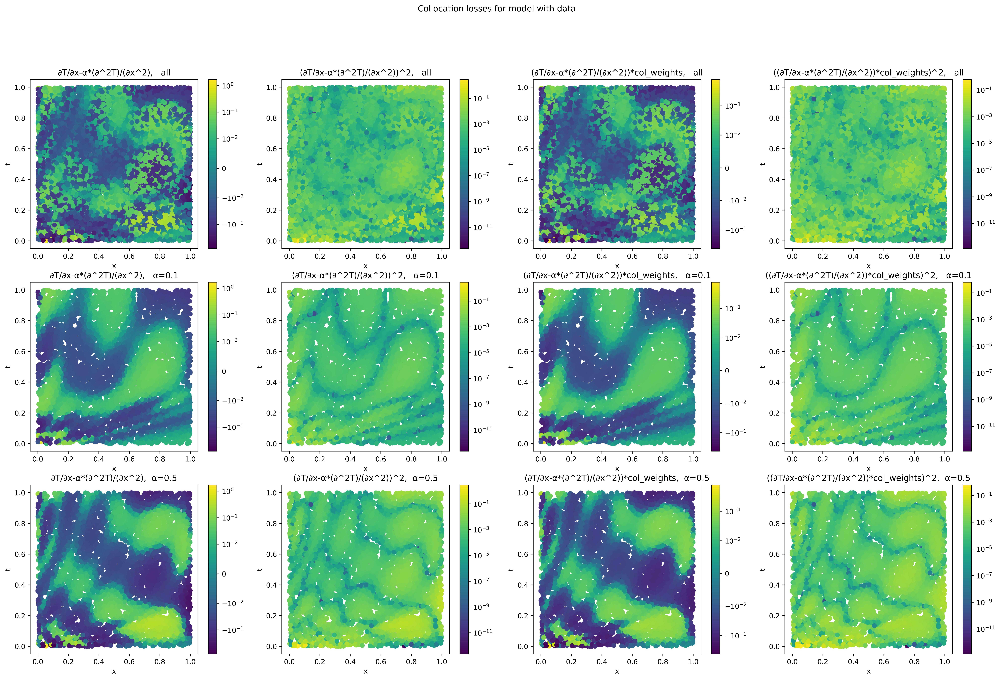

In [ ]:
model_with_data.eval()

fig, ax = plt.subplots(3, 4, figsize=(25, 15), dpi=400)

for i, l in enumerate(losses):
    sc1 = ax[0][i].scatter(
        coll_x.cpu(),
        coll_t.cpu(),
        c=losses[l][0](
            model_with_data,
            torch.cat([coll_x,
                       coll_t,
                       coll_a],
                      dim=1),
            model_with_data.coll_weights).cpu().detach().numpy(),
        norm=losses[l][1])
    fig.colorbar(sc1, ax=ax[0][i])
    ax[0][i].set_xlabel('x')
    ax[0][i].set_ylabel('t')
    ax[0][i].set_title(f'{l},   all')

    sc1 = ax[1][i].scatter(
        coll_x[coll_a == 0.1].cpu(),
        coll_t[coll_a == 0.1].cpu(),
        c=losses[l][0](
            model_with_data,
            torch.cat([coll_x,
                       coll_t,
                       coll_a],
                      dim=1),
            model_with_data.coll_weights)[
                coll_a == 0.1
        ].cpu().detach().numpy(),
        norm=losses[l][1])
    fig.colorbar(sc1, ax=ax[1][i])
    ax[1][i].set_xlabel('x')
    ax[1][i].set_ylabel('t')
    ax[1][i].set_title(f'{l},   α=0.1')

    sc1 = ax[2][i].scatter(
        coll_x[coll_a == 0.5].cpu(),
        coll_t[coll_a == 0.5].cpu(),
        c=losses[l][0](
            model_with_data,
            torch.cat([coll_x,
                       coll_t,
                       coll_a],
                      dim=1),
            model_with_data.coll_weights)[
                coll_a == 0.5
        ].cpu().detach().numpy(),
        norm=losses[l][1])
    fig.colorbar(sc1, ax=ax[2][i])
    ax[2][i].set_xlabel('x')
    ax[2][i].set_ylabel('t')
    ax[2][i].set_title(f'{l},  α=0.5')

plt.suptitle('Collocation losses for model with data')
plt.show()